In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

In [3]:
def load_data(filename):
    m = np.array(pd.read_csv(filename, header=None))
    return np.tril(m) + np.tril(m).transpose()

def show_heapmap(m, title=None, subtitle=None, vmin=None, vmax=None, yticks=True, figsize=None):
    vmin = np.nanmin(m) if vmin is None else vmin
    vmax = np.nanmax(m) if vmax is None else vmax
    black_at = (vmin+3*vmax)/4
    subtitle = "Core-to-core latency" if subtitle is None else subtitle
    
    isnan = np.isnan(m)

    plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = False
    plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = True

    figsize = np.array(m.shape)*0.3 + np.array([6,1]) if figsize is None else figsize
    fig, ax = plt.subplots(figsize=figsize, dpi=130)
    
    fig.patch.set_facecolor('w')
    
    plt.imshow(np.full_like(m, 0.7), vmin=0, vmax=1, cmap = 'gray') # for the alpha value
    plt.imshow(m, cmap = plt.colormaps['viridis'], vmin=vmin, vmax=vmax)
    
    fontsize = 9 if vmax >= 100 else 10

    for (i,j) in np.ndindex(m.shape):
        t = "" if isnan[i,j] else f"{m[i,j]:.1f}" if vmax < 10.0 else f"{m[i,j]:.0f}"
        c = "w" if m[i,j] < black_at else "k"
        plt.text(j, i, t, ha="center", va="center", color=c, fontsize=fontsize)
        
    plt.xticks(np.arange(m.shape[1]), labels=[f"{i+1}" for i in range(m.shape[1])], fontsize=9)
    if yticks:
        plt.yticks(np.arange(m.shape[0]), labels=[f"CPU {i+1}" for i in range(m.shape[0])], fontsize=9)
    else:
        plt.yticks([])

    plt.tight_layout()
    plt.title(f"{title}\n" +
              f"{subtitle}\n" +
              f"Min={vmin:0.1f}ns Median={np.nanmedian(m):0.1f}ns Max={vmax:0.1f}ns",
              fontsize=11, linespacing=1.5)

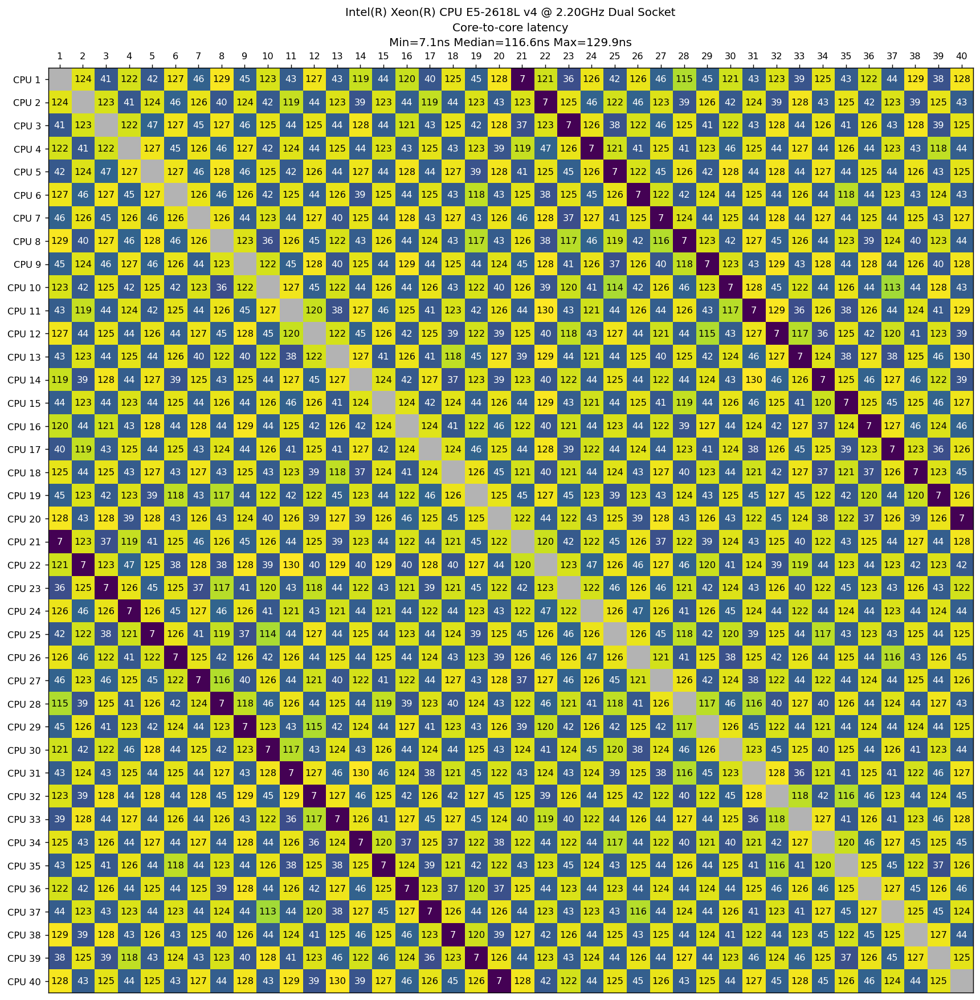

In [3]:
cpu = "Intel(R) Xeon(R) CPU E5-2618L v4 @ 2.20GHz Dual Socket"
fname = "E5-2618L-DS.csv"
m = load_data(fname)
show_heapmap(m, title=cpu)

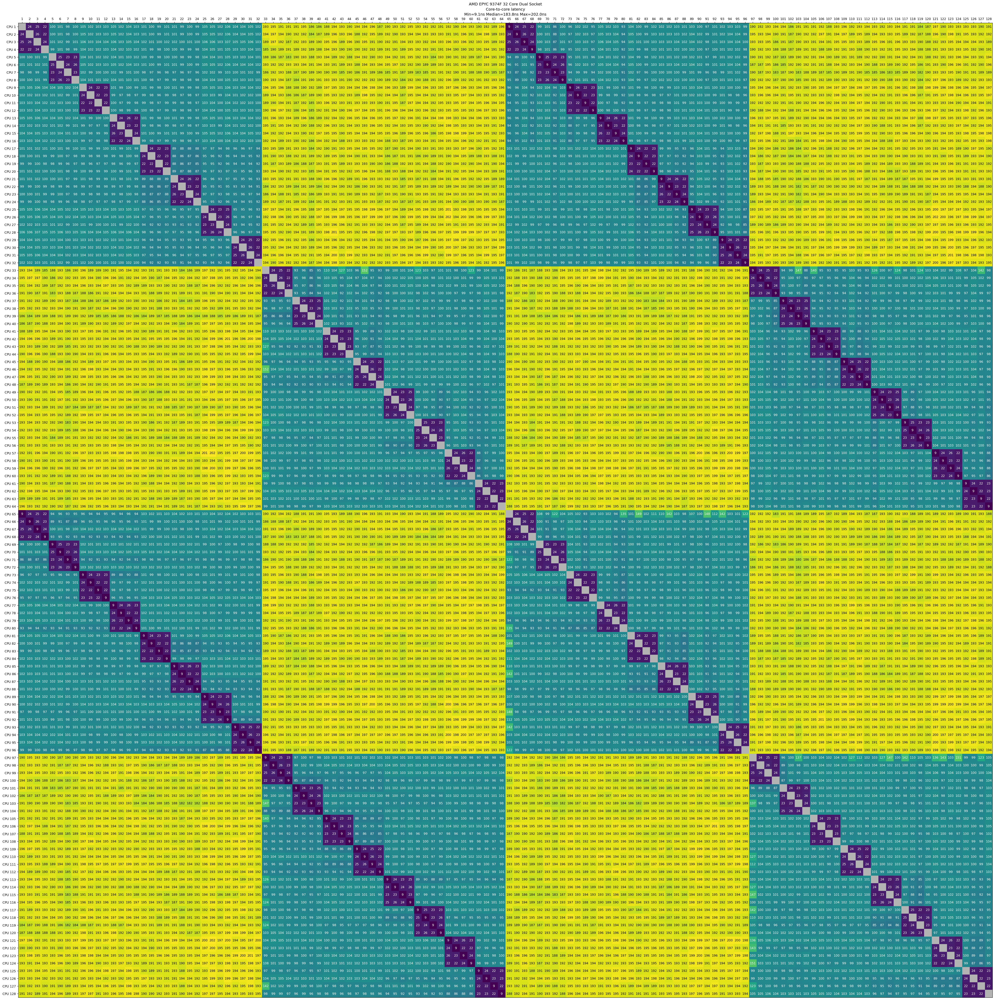

In [4]:
cpu = "AMD EPYC 9374F 32 Core Dual Socket"
fname = "9374F-DS.csv"
m = load_data(fname)
show_heapmap(m, title=cpu)

In [4]:
cpu = "AMD EPYC 9474F 48 Core Dual Socket Server 1"
fname = "9474F-DS-1.csv"
m = load_data(fname)
show_heapmap(m, title=cpu)

In [5]:
cpu = "AMD EPYC 9474F 48 Core Dual Socket Server 2"
fname = "9474F-DS-2.csv"
m = load_data(fname)
show_heapmap(m, title=cpu)